In [36]:
import pandas as pd
from datetime import datetime as dt
import xarray as xr

import re
import numpy as np

import os

import cartopy.crs as ccrs
import cartopy.feature as cfeature

import matplotlib.pyplot as plt

In [37]:
## Read in Station Data
stations = pd.read_csv('../../data_directory/metadata/ctd_stations_SKQ202310S_ToTS.txt', sep='\t')
station_lap = pd.read_csv('../../data_directory/metadata/station_metadata_laps.csv').drop(columns=['section_name_full', 'section', 'sectionStation', 'dist_km'])

print(stations.columns, station_lap.columns)

stations[['station', 'cast']] = stations['StationCast'].str.extract(r'S(\d+)C(\d+)').astype(int)

stations = pd.merge(stations, station_lap[['station', 'lap']], on='station', how='left')
stations

Index(['StationCast', 'Section Name', 'Lat', 'Lon', 'Date', 'Time',
       'Bottom Depth'],
      dtype='object') Index(['station', 'cast', 'lap', 'latitude', 'longitude'], dtype='object')


,StationCast,Section Name,Lat,Lon,Date,Time,Bottom Depth,station,cast,lap
0,S001C01,BS1,65.6193,-168.150,20230617,744,26,1,1,NaN
1,S002C01,BS2,65.6483,-168.272,20230617,857,26,2,1,NaN
2,S003C01,BS3,65.6733,-168.370,20230617,957,51,3,1,NaN
3,S004C01,BS4,65.6942,-168.463,20230617,1059,54,4,1,NaN
4,S005C01,BS5,65.7160,-168.559,20230617,1200,52,5,1,NaN
...,...,...,...,...,...,...,...,...,...,...
313,S296C01,DBO2-9,64.6723,-167.781,20230729,907,35,296,1,NaN
314,S297C01,DBO2-10,64.6713,-167.464,20230729,1017,28,297,1,NaN
315,S298C01,DBO2-11,64.6728,-167.150,20230729,1125,29,298,1,NaN
316,S299C01,DBO2-12,64.6728,-166.835,20230729,1235,25,299,1,NaN


In [38]:
ice_data = pd.read_csv('../../data_directory/metadata/observed_ice_edge_bridgecam_updated072425.csv').rename(columns={
    'ice_obs': 'ice_class',
    'station': 'deployStation'
})
ice_data

,deployStation,ice_class
0,1,ow
1,2,ow
2,3,miz
3,4,miz
4,5,miz
...,...,...
295,296,ow
296,297,ow
297,298,ow
298,299,ow


In [39]:
### Read in trap metadata and merge with station lat/lon/lap info
traps = pd.read_csv('../../data_directory/metadata/trap_metadata.csv')[['Deployment', 'Deploy_Station', 'Recover_Station']]
traps.rename(columns={'Deployment': 'deployment', 'Deploy_Station': 'deployStation', 'Recover_Station': 'recoverStation'}, inplace=True)

## NOTE: The nominal station number for T026 is 174, but 174 was at the
## same position as station 171 within ~12 hours
## For this reason, we did not conduct a CTD cast at 174, and will use 171 for this figure
traps.loc[traps['deployment'] == 'T026', 'deployStation'] = 171

trap_deploy = pd.merge(traps, station_lap, left_on='deployStation', right_on='station', how='left'
                       ).rename(columns={'latitude':'deployLat',
                                         'longitude':'deployLon',
                                         'lap':'deployLap'}
                        ).drop(columns=['station', 'cast'])

trap_recover = pd.merge(traps, station_lap, left_on='recoverStation', right_on='station', how='left'
                        ).rename(columns={'latitude':'recoverLat',
                                          'longitude':'recoverLon',
                                          'lap':'recoverLap'}
                                          ).drop(columns=['station', 'cast'])


trap_metadata = pd.merge(trap_deploy, trap_recover).merge(ice_data, on='deployStation', how='left')
trap_metadata

,deployment,deployStation,recoverStation,deployLap,deployLat,deployLon,recoverLap,recoverLat,recoverLon,ice_class
0,T001,15,15,NaN,70.8893,-161.571,NaN,70.8893,-161.571,ice
1,T001,15,15,NaN,70.8893,-161.571,NaN,70.8830,-161.354,ice
2,T001,15,15,NaN,70.8893,-161.571,NaN,70.8845,-161.310,ice
3,T001,15,15,NaN,70.8893,-161.571,NaN,70.8893,-161.571,ice
4,T001,15,15,NaN,70.8893,-161.571,NaN,70.8830,-161.354,ice
...,...,...,...,...,...,...,...,...,...,...
151,T028,198,252,7.0,71.4202,-164.403,8.0,71.0282,-163.009,ice
152,T029,207,251,7.0,70.9427,-165.189,8.0,70.8588,-164.225,ow
153,T029,207,251,7.0,70.9427,-165.189,8.0,70.8588,-164.225,ow
154,T029,207,251,7.0,70.9427,-165.189,8.0,70.8588,-164.225,ow


In [40]:
## Extract Ends of Hr and HRE sections from velocity data
# import pandas as pd
velocity_data = pd.read_csv('../../data_directory/ADCP_vector_data/interp_uv_0_100_av_jie_mass_balance.dat', delim_whitespace=True, header=None)
# velocity_data.columns = ['lon', 'lat', 'u', 'v']
velocity_data.columns = ['lon', 'lat', 'u', 'v']
velocity_data['u_deg_sec'] = velocity_data['u'] * (1e-5) / (111 * np.cos(np.deg2rad(velocity_data['lat']))) # 1 cm = 10^-5 km, degree = 111 km * cos(latitude)
velocity_data['v_deg_sec'] = velocity_data['v'] * (1e-5) / 111 # 1 cm = 10^-5 km, degree = 111 km
# velocity_data

# Bob velocity data uses slightly different station positions than I did for HR and HRE Lines
# Within 1km margin, but the sligth offset makes the lines look weird
# reset the ends of HR and HRE lines to match velocity data
northernmost_point = velocity_data.loc[velocity_data['lat'].idxmax()]
westernmost_point = velocity_data.loc[velocity_data['lon'].idxmin()]
southernmost_point = velocity_data.loc[velocity_data['lat'].idxmin()]
easternmost_point = velocity_data.loc[velocity_data['lon'].idxmax()]

# HR connects northernmost and westernmost points
hr_ends = pd.concat([northernmost_point.to_frame().T, westernmost_point.to_frame().T], ignore_index=True)

# HRE connects southernmost and easternmost points
hre_ends = pd.concat([southernmost_point.to_frame().T, easternmost_point.to_frame().T], ignore_index=True)

In [41]:
def append_vars_from_trap_metadata(list_of_varNames, trapInteger, outputDataframe):
    for varName in list_of_varNames:
        outputDataframe[varName] = trap_metadata[trap_metadata['deployment']==str('T'+f'{trapInteger:03}')][varName].values[0]


In [42]:
print('T010 Deployment Lap Must be Hardcoded because data is from different spreadsheet')
print('T010 Deployment Lap =', trap_metadata[trap_metadata['deployment']==str('T010')]['deployLap'].values[0])

T010 Deployment Lap Must be Hardcoded because data is from different spreadsheet
T010 Deployment Lap = 2.0


This next code chunk actually reads in the data

In [43]:
list_of_vars = ['deployLap', 'recoverLap', 'ice_class'] #, 'iceTethered', 'shallowTrapDepth', 'deepTrapDepth', 'ice_class'] #, 'shallowFlux', 'deepFlux']

full_deployments = []
recovery_locations = []
for i in range(1, 30):
    if i == 1:
        print('loop'+ f'{i:02}: T001 was a Test Deployment. Track not included.')
    elif i == 10:
        print('loop'+ f'{i:02}: T010 read in separately beacuse track is from Spotter Beacon')
        t010_beaconLost = pd.read_csv('../../data_directory/array_deployment_gps/T010_full_deployment_beaconLoss.csv')
        t010_spotter = pd.read_csv('../../data_directory/array_deployment_gps/T010_full_deployment_spotter.csv')
        append_vars_from_trap_metadata(list_of_vars, 10, t010_spotter)
    elif i == 21:
        print('loop'+ f'{i:02}: T021 read in separately beacuse trap line was lost before recovery')
        t021_beaconPath = pd.read_csv('../../data_directory/array_deployment_gps/T021_full_deployment_beacon.csv')
        t021_beaconPath.rename(columns={'Asset Name':'assetName',
                                        'Data Date (AKDT)':'dateTimeAKDT',
                                        ' Latitude':'latitude',
                                        ' Longitude':'longitude'}, inplace=True)
        t021_trapLine = pd.read_csv('../../data_directory/array_deployment_gps/T021_full_deployment_trapline.csv')
        t021_trapLine.rename(columns={'Asset Name':'assetName',
                                      'Data Date (AKDT)':'dateTimeAKDT',
                                      ' Latitude':'latitude',
                                      ' Longitude':'longitude'}, inplace=True)
        t021_spotter = pd.read_csv('../../data_directory/array_deployment_gps/T021_full_deployment_spotter.csv')
        t021_spotter['time'] = t021_spotter['Epoch Time'].transform(lambda x: dt.fromtimestamp(x)) # epoch time is in AKDT it seems
        t021_spotter = t021_spotter[t021_spotter['time'] >= dt.strptime('2023-07-13 09:48:00', "%Y-%m-%d %H:%M:%S")] # no time points before deploy
        t021_spotter = t021_spotter[t021_spotter['time'] <= dt.strptime('2023-07-17 09:30:00', "%Y-%m-%d %H:%M:%S")] # no time points after recover
    else:
        try:
            df = pd.read_csv('../../data_directory/array_deployment_gps/T'+ f'{i:03}' +'_full_deployment.csv')
            df['trapNum'] = str('T' + f'{i:03}')
            append_vars_from_trap_metadata(list_of_vars, i, df)
            df.rename(columns={'Asset Name':'assetName',
                                'Data Date (AKDT)':'dateTimeAKDT',
                                ' Latitude':'latitude',
                                ' Longitude':'longitude'}, inplace=True)
            full_deployments.append(df)
                            
            recovery_locations.append(pd.DataFrame({'deployment':['T00'+str(i)],
                                                'final_lat':df['latitude'][0],
                                                'final_lon':df['longitude'][0]}))

        
            print('loop'+ f'{i:02}: ' + df['trapNum'].iloc[0] + ' read in successfully')
        except FileNotFoundError:
            print('loop'+ f'{i:02}: T'+ f'{i:03}_full_deployment.csv not Found' )
        except:
            print('Something Else Went Wrong')

loop01: T001 was a Test Deployment. Track not included.
loop02: T002 read in successfully
loop03: T003 read in successfully
loop04: T004 read in successfully
loop05: T005 read in successfully
loop06: T006 read in successfully
loop07: T007 read in successfully
loop08: T008 read in successfully
loop09: T009 read in successfully
loop10: T010 read in separately beacuse track is from Spotter Beacon
loop11: T011 read in successfully
loop12: T012 read in successfully
loop13: T013 read in successfully
loop14: T014 read in successfully
loop15: T015 read in successfully
loop16: T016 read in successfully
loop17: T017 read in successfully
loop18: T018 read in successfully
loop19: T019 read in successfully
loop20: T020 read in successfully
loop21: T021 read in separately beacuse trap line was lost before recovery
loop22: T022 read in successfully
loop23: T023 read in successfully
loop24: T024 read in successfully
loop25: T025 read in successfully
loop26: T026 read in successfully
loop27: T027 read 

In [44]:
## Read in Selected Ice Data

ice_directory = '../../data_directory/SAR_ice_images/'

ice_files = ['0625_FullTrackHighRes_RCM3_OK2530212_PK2622395_1_SCLNB_20230625_173856_HH.nc',
             '0630_FullTrackHighRes_RCM2_OK2313348_PK2628116_1_SCLNA_20230630_041227_HH.nc',
             '0702_FullTrackHighRes_RCM2_OK2417746_PK2630803_1_SCLNB_20230702_042818_HH.nc',
             '0708_FullTrackHighRes_RCM1_OK2417746_PK2640008_1_SCLNB_20230708_041225_HH.nc',
             '0713_FullTrackHighRes_RCM2_OK2417746_PK2646814_1_SCLNB_20230713_041940_HH.nc',
             '0719_FullTrackHighRes_RCM3_OK2496633_PK2656157_1_SCLNB_20230719_173855_HH.nc',
             '0722_FullTrackHighRes_RCM1_OK2496633_PK2660180_1_SCLNB_20230722_173032_HH.nc',
             '0725_FullTrackHighRes_RCM2_OK2496633_PK2663544_1_SCLNB_20230725_042019_HH.nc']

ice_files = [ice_directory + x for x in ice_files]

In [45]:
def read_in_SAR(file):
        with xr.open_dataset(file) as ds:
                ds = ds.isel(y=slice(None, None, 5), x=slice(None, None, 5))
                dataset = ds['band_1']
        return(dataset)

In [46]:
# Read in SAR ice data
lap_ice = [read_in_SAR(file) for file in ice_files]

In [47]:
# Define color mapping for ice classes

# ice_class_colors = {'ow': 'red', 'miz': 'orange', 'ice': 'yellow'}
# ice_class_colors = {'ow': '#F21A00', 'miz': '#FFA500', 'ice': '#FFFF00'} # red orange yellow
# ice_class_colors = {'ow': '#F21A00', 'miz': '#EBCC2A', 'ice': '#3B9AB2'} # red yellow blue
# ice_class_colors = {'ow': '#3B9AB2', 'miz': '#EBCC2A', 'ice': '#F21A00'} # blue yellow red

ice_class_colors = {'ow': "#44C7FF", 'miz': "#FCCE50", 'ice': "#d63a41"}
t010_color = '#44C7FF'

hr_color = "#2d981d"
# hre_color = "#de9f5c"
hre_color = "#00098C"

In [48]:
ice_class_colors

{'ow': '#44C7FF', 'miz': '#FCCE50', 'ice': '#d63a41'}

In [49]:
def filter_by_lap(dataframe, lap_number):
    result = dataframe[dataframe['lap'] == lap_number]
    return(result)

In [50]:
stations_by_lap = [filter_by_lap(stations, i) for i in range(1, 9)] # there are 8 laps

/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/constructive.py:181: RuntimeWarning: invalid value encountered in buffer
  return lib.buffer(
/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


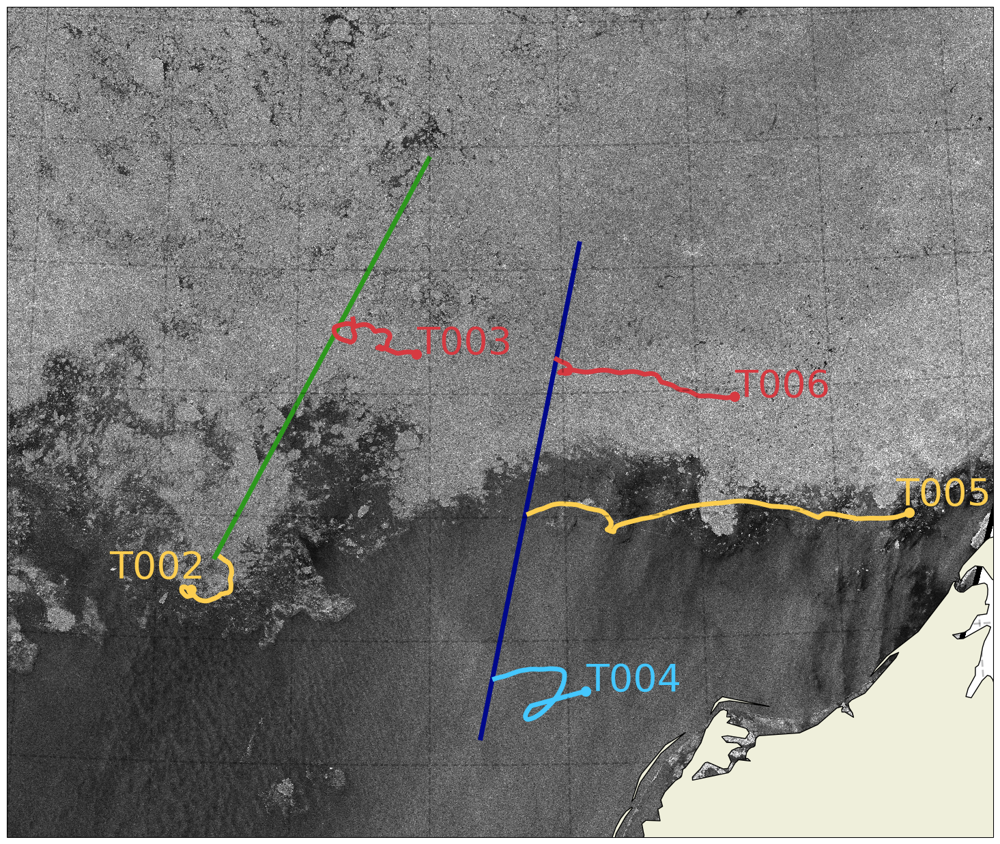

/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/constructive.py:181: RuntimeWarning: invalid value encountered in buffer
  return lib.buffer(
/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


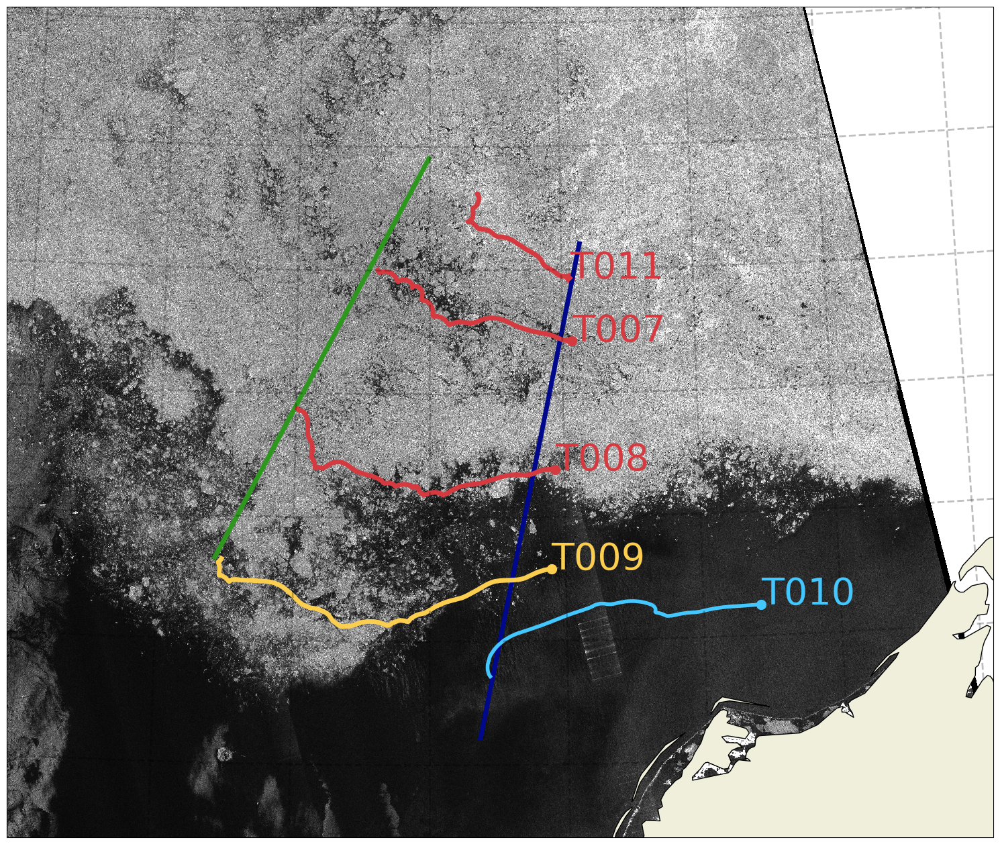

/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/constructive.py:181: RuntimeWarning: invalid value encountered in buffer
  return lib.buffer(
/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


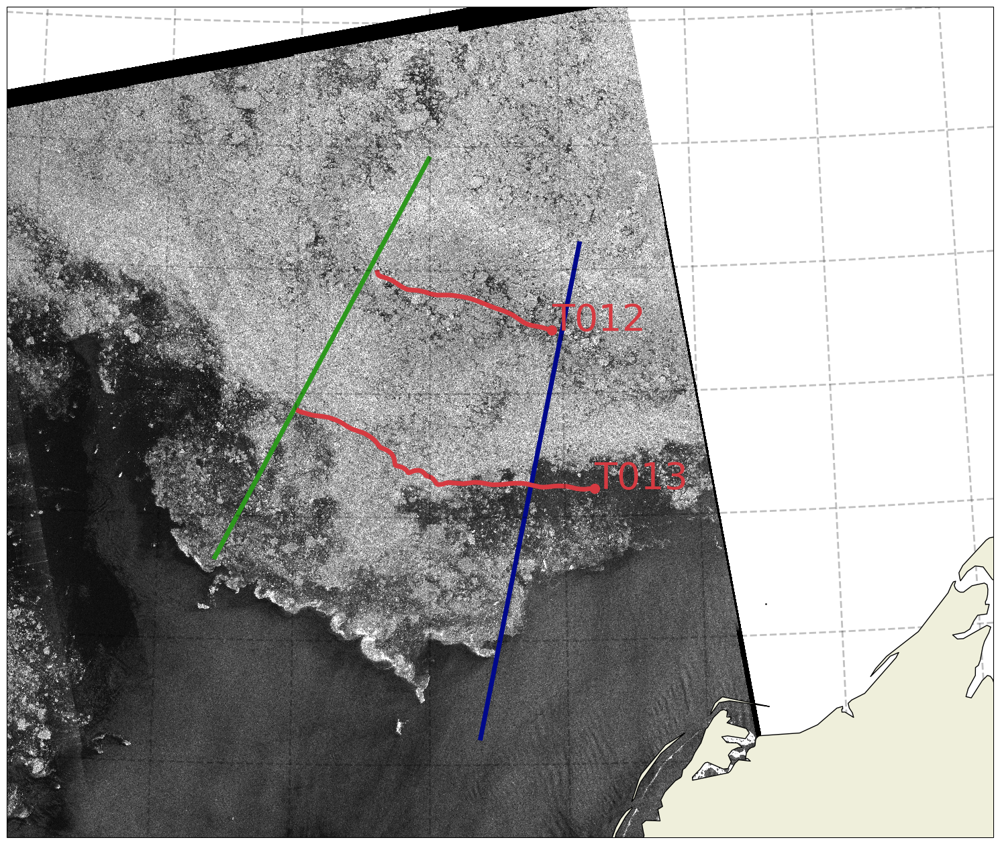

/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/constructive.py:181: RuntimeWarning: invalid value encountered in buffer
  return lib.buffer(
/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


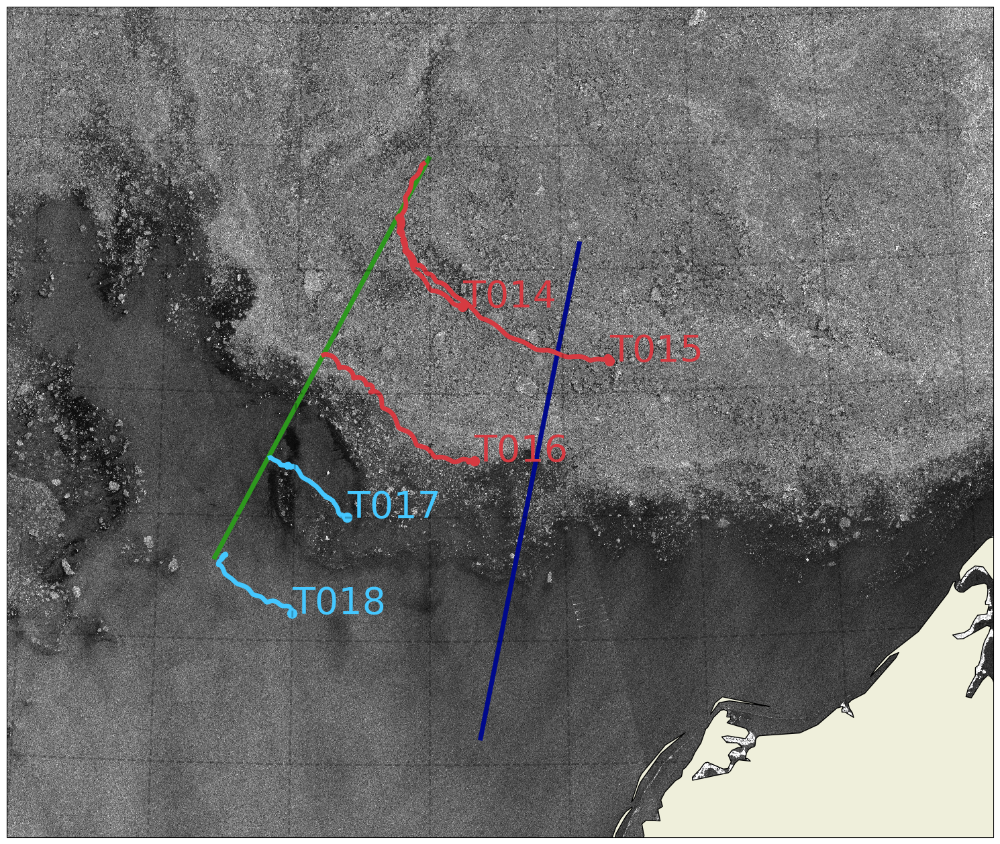

/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/constructive.py:181: RuntimeWarning: invalid value encountered in buffer
  return lib.buffer(
/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


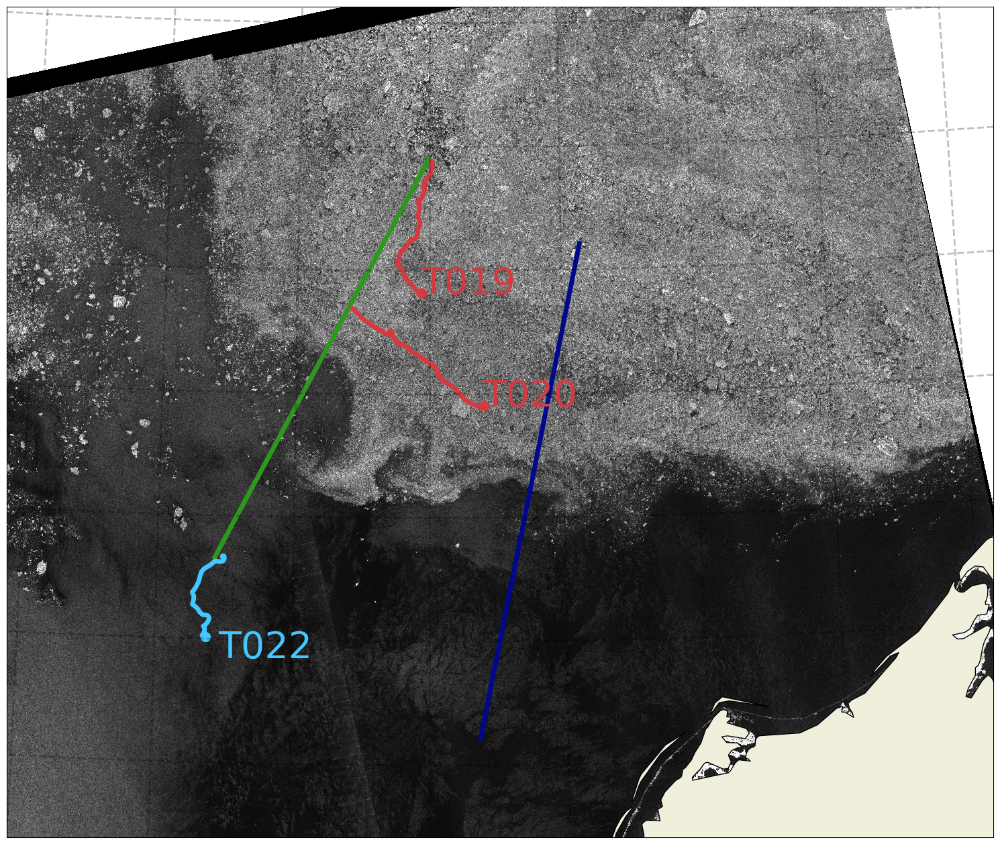

/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/constructive.py:181: RuntimeWarning: invalid value encountered in buffer
  return lib.buffer(
/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


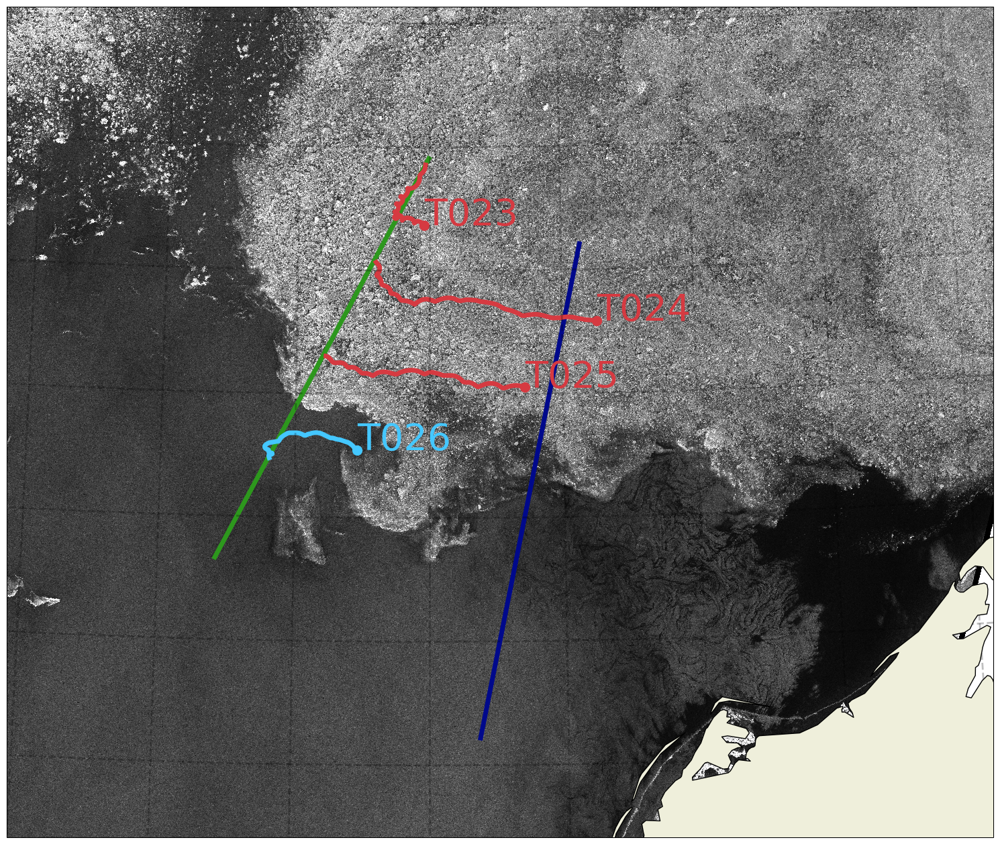

/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/constructive.py:181: RuntimeWarning: invalid value encountered in buffer
  return lib.buffer(
/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


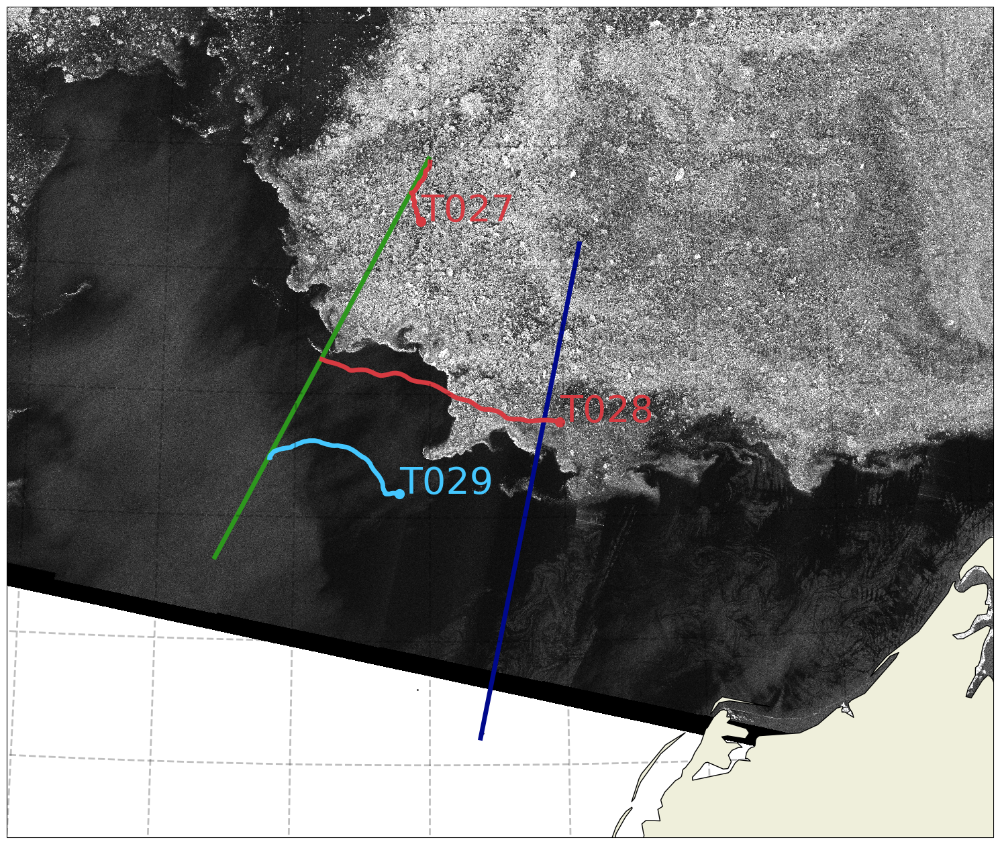

/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/constructive.py:181: RuntimeWarning: invalid value encountered in buffer
  return lib.buffer(
/Users/jameslauer/miniconda3/envs/genericOcean/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


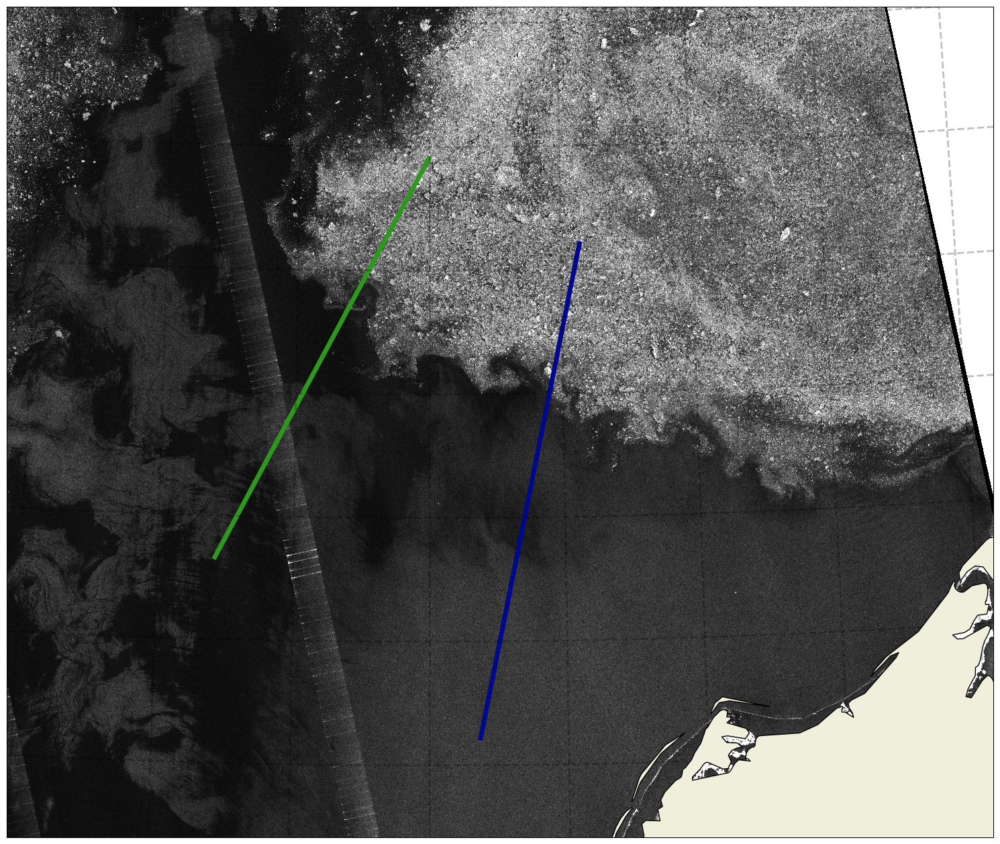

In [51]:
proj = ccrs.Orthographic(central_latitude=71, central_longitude=-164)

extent = [-167, -160, 70, 72]

for i in range(8):
# for i in [4]: # for testing
    plt.figure(figsize=(15.,15.), facecolor='none')
    ax = plt.axes(projection = ccrs.Orthographic(central_latitude=71, central_longitude=-164))
    ax.add_feature(cfeature.LAND, zorder=100)
    ax.add_feature(cfeature.COASTLINE, zorder=100)

    gl = ax.gridlines(crs=ccrs.PlateCarree(), linewidth=2, color='black', alpha=0.25, linestyle='--', draw_labels=False)
    # gl.top_labels = False
    # gl.right_labels = False
    # gl.bottom_labels = False
    # gl.left_labels = False

    extent = [-167, -160, 70, 72]
    ax.set_extent(extent, ccrs.PlateCarree())

    # plot HR and HRE lines
    ax.plot(hr_ends['lon'], hr_ends['lat'], color = hr_color, transform=ccrs.PlateCarree(), linewidth=5)
    ax.plot(hre_ends['lon'], hre_ends['lat'], color = hre_color, transform=ccrs.PlateCarree(), linewidth=5)

    ax.scatter(stations_by_lap[i]['Lon'], stations_by_lap[i]['Lat'], c = 'black', s = 0.75, transform=ccrs.PlateCarree())
    # ax.set_title(str(f'Lap {i+1}'))

    if i == 1: #2:
      # T010 was deployed during lap 2 (indexed in list as 1), recovered during lap 3 (index 2)
      # Plotting in T010 spotter data
      ax.plot(t010_spotter['Longitude (deg)'],
               t010_spotter['Latitude (deg)'],
               alpha = 1,
              #  color = '#F21A00',
               color = t010_color,
               lw = 4,
               transform=ccrs.PlateCarree())
      ax.scatter(t010_spotter['Longitude (deg)'].iloc[0],
                 t010_spotter['Latitude (deg)'].iloc[0],
                 s=100,
                 # color = '#F21A00',
                 color = t010_color,
                 alpha = 1,
                 zorder = 200,
                 transform=ccrs.PlateCarree())
      # Label End Point
      ax.text(t010_spotter['Longitude (deg)'].iloc[0],
        t010_spotter['Latitude (deg)'].iloc[0],
        'T010',
        fontsize=40,
        # color='#F21A00',  # Set text color to match line
        color = t010_color,
        transform=ccrs.PlateCarree())

    list_of_deployments = []
    for df in full_deployments:
        # cumulative plot - shows traps recovered on current lap and all before
        # if df['deployLap'].values[0]<= i:
        # recovery on current lap ONLY!
        # if df['deployLap'].values[0] == i:
        # DEPLOYMENT on current lap only
        if df['deployLap'].values[0] == i+1:
            list_of_deployments.append(df)

    # list_of_deployments
    iceData = lap_ice[i]
    ax.pcolormesh(iceData.lon.values,
                  iceData.lat.values,
                  iceData.values,
                  cmap='gray',
                  vmax=iceData.mean()*2,
                  transform=ccrs.PlateCarree())


    for j in range(len(list_of_deployments)):
        ice_class = list_of_deployments[j]['ice_class'].iloc[0]

        ## plot the entire track
        ax.plot(list_of_deployments[j]['longitude'],
                   list_of_deployments[j]['latitude'],
                   lw = 5, 
                   color = ice_class_colors.get(ice_class, 'gray'),
                #    color = 'green',
                   alpha = 1,
                   transform=ccrs.PlateCarree())
        
        ax.scatter(list_of_deployments[j]['longitude'].iloc[0],
                   list_of_deployments[j]['latitude'].iloc[0],
                   s = 100,
                   color = ice_class_colors.get(ice_class, 'gray'),
                #    color = 'green',
                   alpha = 1,
                   transform = ccrs.PlateCarree())
        
        # ax.text(list_of_deployments[j]['longitude'].iloc[0],
        #         list_of_deployments[j]['latitude'].iloc[0],
        #         str(list_of_deployments[j]['trapNum'].iloc[0]),
        #         fontsize=40,
        #         color=ice_class_colors.get(ice_class, 'gray'),  # Set text color to match line
        #         transform = ccrs.PlateCarree())

        # T002 and T005 need text offset to avoid overlapping with track or going off the plot
        if str(list_of_deployments[j]['trapNum'].iloc[0]) == 'T002':
            ax.text(list_of_deployments[j]['longitude'].iloc[0] - 0.6,
                    list_of_deployments[j]['latitude'].iloc[0] + 0.02,
                    str(list_of_deployments[j]['trapNum'].iloc[0]),
                    fontsize=40,
                    color=ice_class_colors.get(ice_class, 'gray'),  # Set text color to match line
                    transform = ccrs.PlateCarree())
        elif str(list_of_deployments[j]['trapNum'].iloc[0]) == 'T005':
            ax.text(list_of_deployments[j]['longitude'].iloc[0] - 0.1,
                    list_of_deployments[j]['latitude'].iloc[0] + 0.02,
                    str(list_of_deployments[j]['trapNum'].iloc[0]),
                    fontsize=40,
                    color=ice_class_colors.get(ice_class, 'gray'),  # Set text color to match line
                    transform = ccrs.PlateCarree())
        elif str(list_of_deployments[j]['trapNum'].iloc[0]) == 'T022':
            ax.text(list_of_deployments[j]['longitude'].iloc[0] + 0.1,
                    list_of_deployments[j]['latitude'].iloc[0] - 0.05, # moved south needs adjustment below point
                    str(list_of_deployments[j]['trapNum'].iloc[0]),
                    fontsize=40,
                    color=ice_class_colors.get(ice_class, 'gray'),  # Set text color to match line
                    transform = ccrs.PlateCarree())
        else:
            ax.text(list_of_deployments[j]['longitude'].iloc[0],
                    list_of_deployments[j]['latitude'].iloc[0],
                    str(list_of_deployments[j]['trapNum'].iloc[0]),
                    fontsize=40,
                    color=ice_class_colors.get(ice_class, 'gray'),  # Set text color to match line
                    transform = ccrs.PlateCarree())
        
    
    plt.tight_layout()
    plt.savefig(str(f'../plot/Lap_{i+1}.png'), bbox_inches = 'tight', dpi = 300, transparent = True)
    plt.show()